In [47]:
import pandas as pd
import numpy as np
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import seaborn as sns

import statsmodels.api as sm
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.stattools import kpss
from statsmodels.tsa.stattools import adfuller

from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score

import warnings
warnings.filterwarnings('ignore')

import pickle

In [2]:
eda = pd.read_csv('EDA_complete_1201.csv', index_col=0)
eda.index = pd.to_datetime(eda.index)
eda

,Ahu1_inv,Ahu2_inv,Ahu3_inv,Ahu4_inv,Ahu5_inv,Ahu6_inv,Ahu7_inv,Ahu8_inv,Ahu9_inv,Ahu10_inv,...,Plant9_pm10,Plant9_temperature,Plant9_humidity,Plant10_air,Plant10_monoxide,Plant10_dioxide,Plant10_pm2d5,Plant10_pm10,Plant10_temperature,Plant10_humidity
2023-01-31 10:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,87.0,24.43,32.47,282.0,0.0,460.0,82.0,92.0,24.88,31.50
2023-01-31 10:10:00,30.0,0.0,30.0,0.0,30.0,0.0,30.0,30.0,30.0,0.0,...,90.0,24.77,32.51,334.0,1.0,461.0,82.0,92.0,25.26,31.61
2023-01-31 10:20:00,30.0,0.0,30.0,0.0,30.0,0.0,30.0,30.0,30.0,0.0,...,85.0,25.06,32.18,523.0,1.0,470.0,84.0,95.0,25.57,31.19
2023-01-31 10:30:00,30.0,0.0,30.0,0.0,30.0,0.0,30.0,30.0,30.0,0.0,...,74.0,25.35,31.33,320.0,1.0,483.0,77.0,87.0,25.72,30.55
2023-01-31 10:40:00,30.0,0.0,30.0,0.0,30.0,0.0,30.0,30.0,30.0,0.0,...,71.0,25.66,30.97,304.0,1.0,466.0,77.0,87.0,26.01,30.24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-08-01 15:20:00,40.0,35.0,40.0,40.0,40.0,35.0,35.0,36.0,36.0,40.0,...,2.0,31.45,54.25,0.0,0.0,553.0,6.0,7.0,31.32,54.64
2023-08-01 15:30:00,40.0,35.0,40.0,40.0,40.0,35.0,35.0,36.0,36.0,40.0,...,5.0,31.45,54.15,0.0,2.0,534.0,6.0,6.0,31.23,54.74
2023-08-01 15:40:00,40.0,35.0,40.0,40.0,40.0,35.0,35.0,36.0,36.0,40.0,...,4.0,31.35,54.55,0.0,0.0,557.0,6.0,6.0,31.29,54.61
2023-08-01 15:50:00,40.0,35.0,40.0,40.0,40.0,35.0,35.0,36.0,36.0,40.0,...,4.0,31.35,54.71,0.0,2.0,544.0,5.0,5.0,31.15,55.20


In [3]:
ahu = eda.iloc[:, :14]
for col in ahu.columns:
    ahu[col] = np.where(((ahu[col].index.hour >= 22)|(ahu[col].index.hour < 7))&(ahu[col]>0), 1, 0)
ahu

,Ahu1_inv,Ahu2_inv,Ahu3_inv,Ahu4_inv,Ahu5_inv,Ahu6_inv,Ahu7_inv,Ahu8_inv,Ahu9_inv,Ahu10_inv,Ahu11_inv,Ahu12_inv,Ahu13_inv,Ahu14_inv
2023-01-31 10:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2023-01-31 10:10:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2023-01-31 10:20:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2023-01-31 10:30:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2023-01-31 10:40:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-08-01 15:20:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2023-08-01 15:30:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2023-08-01 15:40:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2023-08-01 15:50:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [4]:
ahu.sum()

Ahu1_inv      69
Ahu2_inv      55
Ahu3_inv      69
Ahu4_inv      54
Ahu5_inv     121
Ahu6_inv      54
Ahu7_inv      72
Ahu8_inv     101
Ahu9_inv      69
Ahu10_inv     54
Ahu11_inv     69
Ahu12_inv    109
Ahu13_inv     77
Ahu14_inv     62
dtype: int64

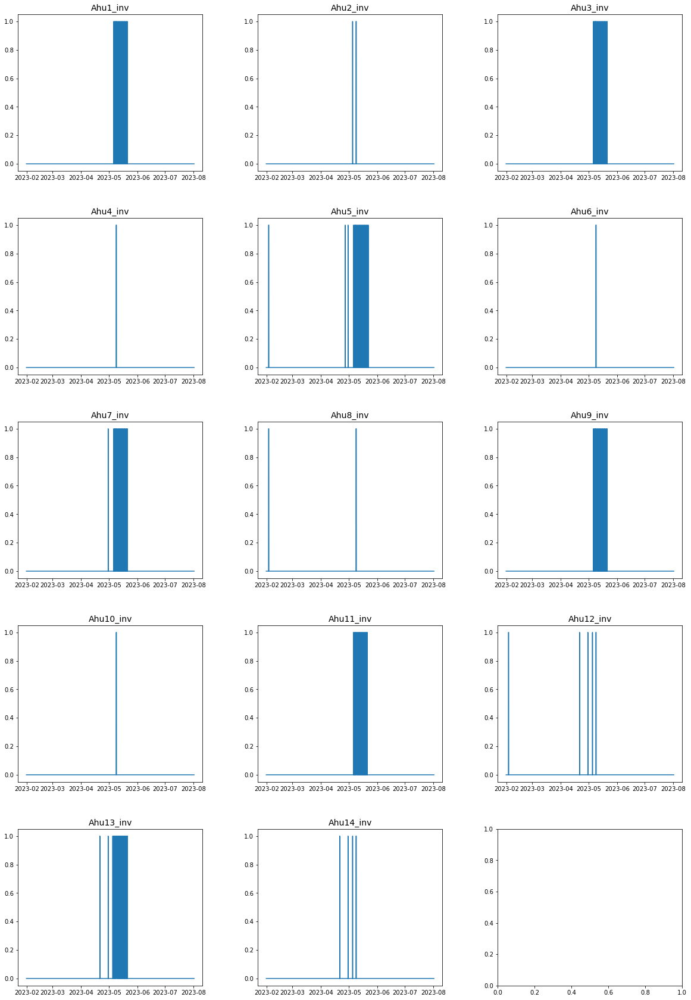

In [5]:
f, axes = plt.subplots(5, 3)
f.set_size_inches((20, 30))
plt.subplots_adjust(wspace = 0.3, hspace = 0.3)

for i in range(0, 14):
    axes[i//3][i%3].plot(ahu.index, ahu.iloc[:,i])
    axes[i//3][i%3].set_title(ahu.columns[i], fontsize = 14)

plt.show()

In [6]:
pearson_corr = eda.corr(method='pearson')

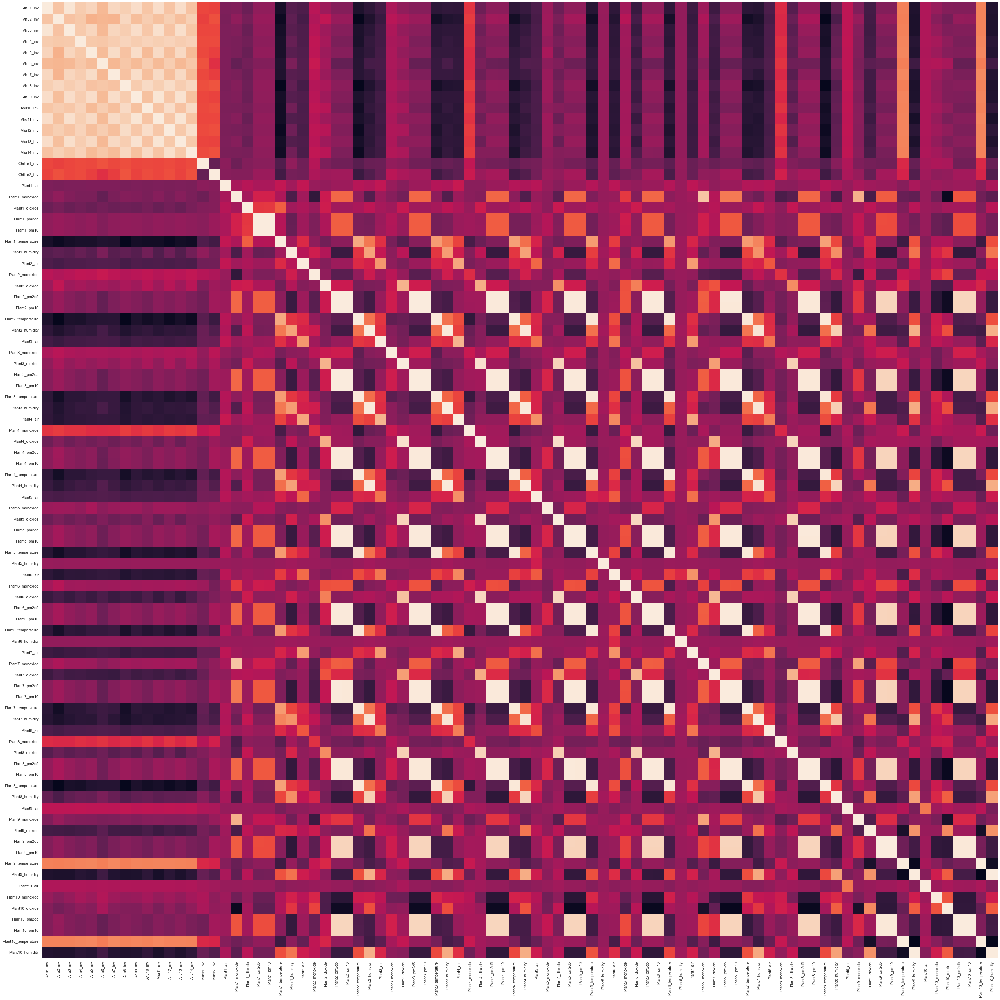

In [7]:
sns.set(font_scale=5.0)
sns.set(rc={'figure.figsize':(40,40)})

heatmap = sns.heatmap(eda.corr(method='pearson').values, # 데이터
                          cbar = False, # 오른쪽 컬러 막대 출력 여부
                           annot = False, # 차트에 숫자를 보여줄 것인지 여부
                          annot_kws={'size' : 2}, # 숫자 출력 시 숫자 크기 조절
                           fmt = '.2f', # 숫자의 출력 소수점자리 개수 조절
                           square = 'True', # 차트를 정사각형으로 할 것인지
                          yticklabels=eda.corr(method='pearson').columns, # y축에 컬럼명 출력
                          xticklabels=eda.corr(method='pearson').columns) # x축에 컬럼명 출력

plt.tight_layout()
plt.show()

In [8]:
pearson_corr['Plant2_temperature'].sort_values(ascending=False).head(20)

Plant2_temperature    1.000000
Plant4_temperature    0.989150
Plant3_temperature    0.987627
Plant8_temperature    0.982960
Plant7_temperature    0.980802
Plant6_temperature    0.975613
Plant5_temperature    0.973816
Plant1_temperature    0.724934
Plant2_humidity       0.531947
Plant7_humidity       0.519191
Plant3_humidity       0.515945
Plant4_humidity       0.488339
Plant10_humidity      0.406979
Plant9_humidity       0.404447
Plant4_air            0.396409
Plant6_air            0.395784
Plant8_humidity       0.352211
Plant3_air            0.321223
Plant1_humidity       0.310699
Plant7_air            0.289640
Name: Plant2_temperature, dtype: float64

In [9]:
pearson_corr['Plant2_temperature'].sort_values(ascending=True).head(20)

Ahu2_inv          -0.590139
Ahu8_inv          -0.589801
Ahu12_inv         -0.560287
Ahu14_inv         -0.559897
Ahu10_inv         -0.533125
Ahu13_inv         -0.504982
Ahu11_inv         -0.497773
Ahu4_inv          -0.495694
Ahu3_inv          -0.491346
Ahu1_inv          -0.484102
Ahu9_inv          -0.481838
Ahu5_inv          -0.451844
Ahu6_inv          -0.442105
Ahu7_inv          -0.437072
Plant4_monoxide   -0.399752
Chiller2_inv      -0.363439
Plant9_pm10       -0.279399
Plant9_pm2d5      -0.279126
Plant7_pm2d5      -0.274441
Plant8_pm10       -0.274258
Name: Plant2_temperature, dtype: float64

In [10]:
data = [eda[[i]] for i in eda.columns]
name = eda.columns.tolist()

stat_data = []
stat_name = []
# non-stationary
nstat_data = []
nstat_name = []
diff1_data = []
diff1_name = []
diff2_data = []
diff2_name = []

# print(len(data),len(name))

for index,var in enumerate(data):
# ADF 검정 수행
    result = kpss(var.dropna())
    adf_statistic = result[0]
    p_value = result[1]

    # print(f'ADF 통계량: {adf_statistic}')
    # print(f'p-value: {p_value}')

    if p_value <= 0.05:
        print(f'KPSS 검정결과 {name[index]} 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.')

        # log = np.log1p(var)
        # log_first = pd.Series(var).diff().dropna()
        log_first = np.log1p(var.dropna()).diff().dropna()

        result = kpss(log_first)
        adf_statistic = result[0]
        p_value = result[1]

        # print(f'>> ADF 통계량: {adf_statistic}')
        # print(f'>> p-value: {p_value}')

        if p_value <= 0.05:
            print(f'>> KPSS 검정결과 1차분한 {name[index]} 시계열 데이터가 정상성을 가지지 않습니다.')

            log_second = np.log1p(var).diff().diff().dropna()

            result = kpss(log_second)
            adf_statistic = result[0]
            p_value = result[1]

            # print(f'>>>> ADF 통계량: {adf_statistic}')
            # print(f'>>>> p-value: {p_value}')

            if p_value <=0.05:
                print(f'>>>> KPSS 검정결과 2차분한 {name[index]} 시계열 데이터가 정상성을 가지지 않습니다.')
                nstat_data.append(var)
                nstat_name.append(name[index])

            else:
                print(f'>>>> KPSS 검정결과 2차분한 {name[index]} 시계열 데이터가 정상성을 가집니다.')
                diff2_data.append(var)
                diff2_name.append(name[index])

        else:
            print(f'>>>> KPSS 검정결과 1차분한 {name[index]} 시계열 데이터가 정상성을 가집니다.')
            diff1_data.append(var)
            diff1_name.append(name[index])

    else:
        print(f'ADF 검정결과 {name[index]} 시계열 데이터가 정상성을 가집니다.')
        stat_data.append(var)
        stat_name.append(name[index])


    print()

print("정상성 :", stat_name)
print("1차분결과 정상성: ", diff1_name)
print("2차분결과 정상성: ", diff2_name)
print('정상성 안띰 :', nstat_name)

KPSS 검정결과 Ahu1_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu1_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu2_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu2_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu3_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu3_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu4_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu4_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu5_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu5_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu6_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu6_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu7_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu7_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu8_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu8_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu9_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한 Ahu9_inv 시계열 데이터가 정상성을 가집니다.

KPSS 검정결과 Ahu10_inv 시계열 데이터가 정상성을 가지지 않으므로 차분을 계산합니다.
>>>> KPSS 검정결과 1차분한

In [11]:
kpss_result = pd.DataFrame()
kpss_index = eda.columns
kpss_result.index = kpss_index
kpss_result['정상성'] = ['O' if i in stat_name else "X" for i in kpss_index]
kpss_result['1차분 정상성'] = ['O' if i in diff1_name else "X" for i in kpss_index]
kpss_result['2차분 정상성'] = ['O' if i in diff2_name else "X" for i in kpss_index]
kpss_result['정상성 안띰'] = ['O' if i in nstat_name else "X" for i in kpss_index]
kpss_result

def replace_after_o(row):
    o_found = False
    for i in range(len(row)):
        if row[i] == 'O':
            o_found = True
        elif o_found and row[i] == 'X':
            row[i] = '-'
    return row

# Apply the function to each row of the dataframe
kpss_result = kpss_result.apply(replace_after_o, axis=1)
kpss_result

,정상성,1차분 정상성,2차분 정상성,정상성 안띰
Ahu1_inv,X,O,-,-
Ahu2_inv,X,O,-,-
Ahu3_inv,X,O,-,-
Ahu4_inv,X,O,-,-
Ahu5_inv,X,O,-,-
...,...,...,...,...
Plant10_dioxide,X,O,-,-
Plant10_pm2d5,X,O,-,-
Plant10_pm10,X,O,-,-
Plant10_temperature,X,O,-,-


In [12]:
print("정상성 :", stat_name)
print("1차분결과 정상성: ", diff1_name)

정상성 : ['Plant2_air', 'Plant3_air', 'Plant3_dioxide', 'Plant4_air', 'Plant4_dioxide', 'Plant5_air', 'Plant6_dioxide', 'Plant6_humidity', 'Plant7_air']
1차분결과 정상성:  ['Ahu1_inv', 'Ahu2_inv', 'Ahu3_inv', 'Ahu4_inv', 'Ahu5_inv', 'Ahu6_inv', 'Ahu7_inv', 'Ahu8_inv', 'Ahu9_inv', 'Ahu10_inv', 'Ahu11_inv', 'Ahu12_inv', 'Ahu13_inv', 'Ahu14_inv', 'Chiller1_inv', 'Chiller2_inv', 'Plant1_air', 'Plant1_monoxide', 'Plant1_dioxide', 'Plant1_pm2d5', 'Plant1_pm10', 'Plant1_temperature', 'Plant1_humidity', 'Plant2_monoxide', 'Plant2_dioxide', 'Plant2_pm2d5', 'Plant2_pm10', 'Plant2_temperature', 'Plant2_humidity', 'Plant3_monoxide', 'Plant3_pm2d5', 'Plant3_pm10', 'Plant3_temperature', 'Plant3_humidity', 'Plant4_monoxide', 'Plant4_pm2d5', 'Plant4_pm10', 'Plant4_temperature', 'Plant4_humidity', 'Plant5_monoxide', 'Plant5_dioxide', 'Plant5_pm2d5', 'Plant5_pm10', 'Plant5_temperature', 'Plant5_humidity', 'Plant6_air', 'Plant6_monoxide', 'Plant6_pm2d5', 'Plant6_pm10', 'Plant6_temperature', 'Plant7_monoxide', 'Pla

In [13]:
temp = eda[[f'Plant{i}_temperature' for i in range(1,11)]]
temp.head()

,Plant1_temperature,Plant2_temperature,Plant3_temperature,Plant4_temperature,Plant5_temperature,Plant6_temperature,Plant7_temperature,Plant8_temperature,Plant9_temperature,Plant10_temperature
2023-01-31 10:00:00,27.26,25.84,26.13,26.04,25.81,26.22,25.86,26.84,24.43,24.88
2023-01-31 10:10:00,26.48,25.88,25.96,25.96,25.64,26.15,25.79,26.84,24.77,25.26
2023-01-31 10:20:00,26.39,25.75,25.80,25.77,25.45,26.02,25.60,26.74,25.06,25.57
2023-01-31 10:30:00,25.87,25.63,25.72,25.60,25.27,25.89,25.46,26.65,25.35,25.72
2023-01-31 10:40:00,25.43,25.63,25.66,25.53,25.24,25.90,25.34,26.58,25.66,26.01


In [14]:
max_lag = 8

dict_granger = {}
for col in temp.columns:
    y = temp[[col]]
    stat_dct = {}
    stat_name_iter = stat_name
    stat_data_iter = [eda[[stat_name_iter[i]]] for i in range(len(stat_name_iter))]
    for j in range(len(stat_data_iter)):
        test = pd.concat([stat_data_iter[j],np.log1p(y).diff()], axis=1).dropna()
        stat_dct[stat_name_iter[j]] = []
        try:
            result = grangercausalitytests(test,maxlag= max_lag,verbose=False) # lag 8
            k=0
            for i in range(1,max_lag+1):
                # ssr F test & chi2 test , likelihood ratio test , parameter F test => 4개중 3개이상 유의수준보다 작으면 인과관계 있다고 판단.
                if sum([result[i][0]['ssr_ftest'][1]<0.05, result[i][0]['ssr_chi2test'][1]<0.05, result[i][0]['lrtest'][1]<0.05, result[i][0]['params_ftest'][1]<0.05])>=4:
                    k+=1
                if k==max_lag:
                    stat_dct[stat_name_iter[j]].append(i)
        except: 
            pass
    
    diff1_dct = {}
    diff1_data_iter = [eda[[diff1_name[i]]] for i in range(len(diff1_name))]
    diff1_name_iter = diff1_name

    for j in range(len(diff1_data_iter)):
        test = pd.concat([diff1_data_iter[j].diff().diff(),np.log1p(y).diff()], axis=1).dropna()
        diff1_dct[diff1_name_iter[j]] = []
        try:
            result = grangercausalitytests(test,maxlag= max_lag,verbose=False) # lag 8
            k=0
            for i in range(1,max_lag+1):
                # ssr F test & chi2 test , likelihood ratio test , parameter F test => 4개중 3개이상 유의수준보다 작으면 인과관계 있다고 판단.
                if sum([result[i][0]['ssr_ftest'][1]<0.05, result[i][0]['ssr_chi2test'][1]<0.05, result[i][0]['lrtest'][1]<0.05, result[i][0]['params_ftest'][1]<0.05])>=4:
                # if sum([result[i][0]['ssr_ftest'][1]<0.05, result[i][0]['ssr_chi2test'][1]<0.05]) >=3 :
                    k+=1
                if k==max_lag:
                    diff1_dct[diff1_name_iter[j]].append(i)
        except: pass
    
    causality_dct = {**stat_dct, **diff1_dct}
    filtered_caus = [k for k, v in causality_dct.items() if v]
    dict_granger[col] = filtered_caus

dict_granger

{'Plant1_temperature': ['Plant2_air',
  'Plant3_air',
  'Plant3_dioxide',
  'Plant4_air',
  'Plant4_dioxide',
  'Plant5_air',
  'Plant6_dioxide',
  'Plant7_air',
  'Ahu1_inv',
  'Ahu2_inv',
  'Ahu3_inv',
  'Ahu4_inv',
  'Ahu5_inv',
  'Ahu6_inv',
  'Ahu7_inv',
  'Ahu8_inv',
  'Ahu9_inv',
  'Ahu11_inv',
  'Ahu13_inv',
  'Ahu14_inv',
  'Plant1_air',
  'Plant1_monoxide',
  'Plant1_dioxide',
  'Plant1_pm2d5',
  'Plant1_pm10',
  'Plant1_temperature',
  'Plant1_humidity',
  'Plant2_dioxide',
  'Plant2_temperature',
  'Plant3_humidity',
  'Plant4_temperature',
  'Plant5_temperature',
  'Plant6_temperature'],
 'Plant2_temperature': ['Plant3_dioxide',
  'Plant4_air',
  'Plant4_dioxide',
  'Plant5_air',
  'Plant6_dioxide',
  'Plant7_air',
  'Ahu1_inv',
  'Ahu2_inv',
  'Ahu3_inv',
  'Ahu4_inv',
  'Ahu5_inv',
  'Ahu6_inv',
  'Ahu7_inv',
  'Ahu8_inv',
  'Ahu9_inv',
  'Ahu10_inv',
  'Ahu11_inv',
  'Ahu12_inv',
  'Ahu13_inv',
  'Ahu14_inv',
  'Chiller1_inv',
  'Chiller2_inv',
  'Plant1_dioxide',
  'Pl

In [15]:
def crosscorr(datax, datay, lag=0, wrap=False):
    """ Lag-N cross correlation.
    Shifted data filled with NaNs

    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length
    wrap : NaN 채우는 것. shift 하면서 사라진 값으로 다시 채우기. 값이 순환되게 된다. wrap=False 이면 NaN은 drop하고 correlation 구한다.
    Returns
    ----------
    crosscorr : float
    """
    if wrap:
        shiftedy = datay.shift(lag)
        shiftedy.iloc[:lag] = datay.iloc[-lag:].values
        return datax.corr(shiftedy)
    else:
        return datax.corr(datay.shift(lag))

{'Plant1_temperature': {'Plant3_dioxide': [0.5049233386844727, 838.0],
  'Plant6_dioxide': [0.5015042547404354, 28.0],
  'Ahu1_inv': [0.6117078936745431, -425.0],
  'Ahu2_inv': [0.5949856896784009, 869.0],
  'Ahu3_inv': [0.6103080075498298, 295.0],
  'Ahu4_inv': [0.6152375161538606, -425.0],
  'Ahu5_inv': [0.6270881797428779, -569.0],
  'Ahu6_inv': [0.5838998805786426, -139.0],
  'Ahu7_inv': [0.6270451318077578, 7.0],
  'Ahu8_inv': [0.6004947180449643, -426.0],
  'Ahu9_inv': [0.612672682817458, -426.0],
  'Ahu11_inv': [0.6144988179051162, 6.0],
  'Ahu13_inv': [0.6116044014566867, 871.0],
  'Ahu14_inv': [0.5868065577093325, -859.0],
  'Plant1_temperature': [0.5483771081283911, -88.0],
  'Plant2_dioxide': [0.5253335668036656, 841.0],
  'Plant2_temperature': [0.6028360558695762, -74.0],
  'Plant3_humidity': [0.5473063209780985, -948.0],
  'Plant4_temperature': [0.5709455661151894, -74.0],
  'Plant5_temperature': [0.5634766215516542, -72.0],
  'Plant6_temperature': [0.5360103077494883, -74

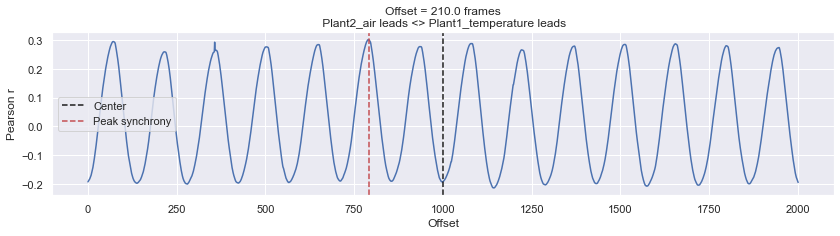

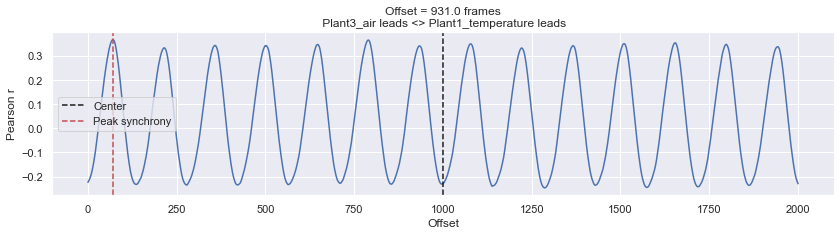

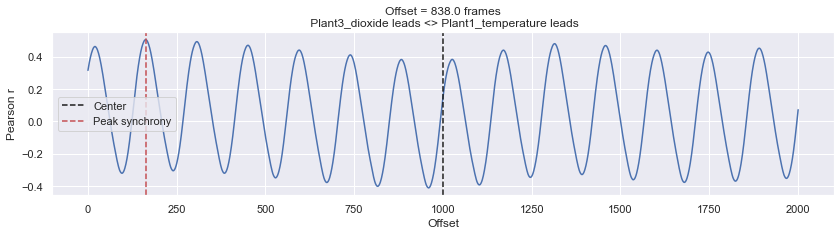

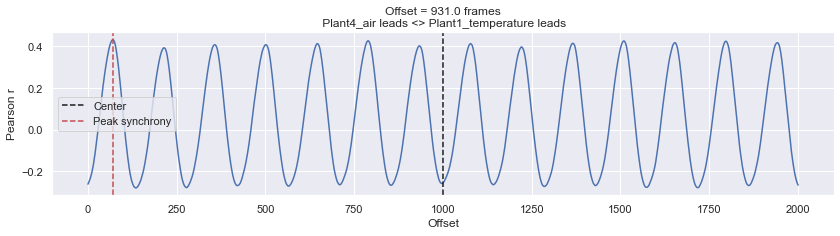

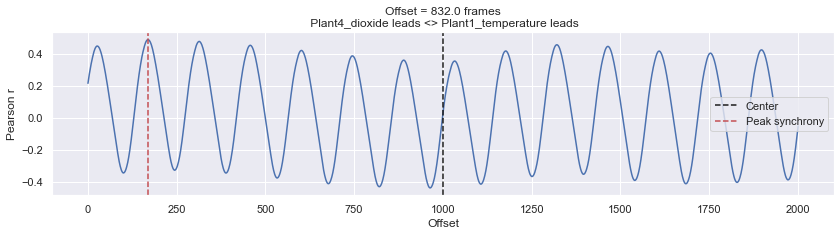

...

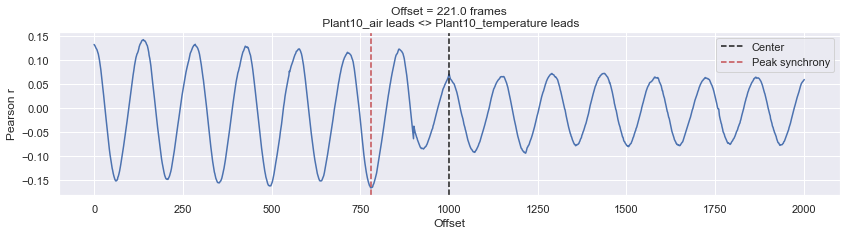

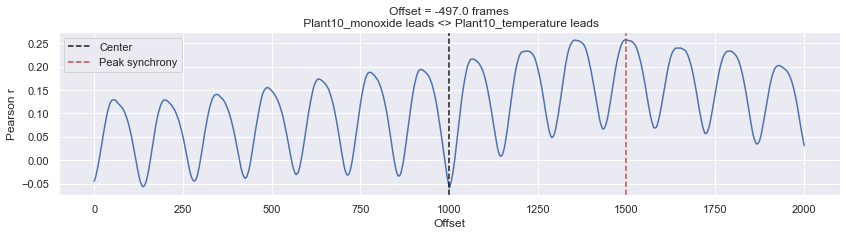

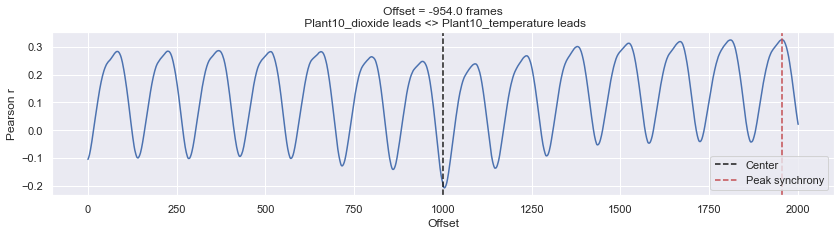

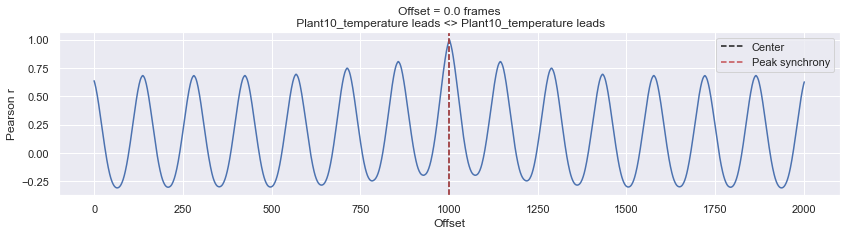

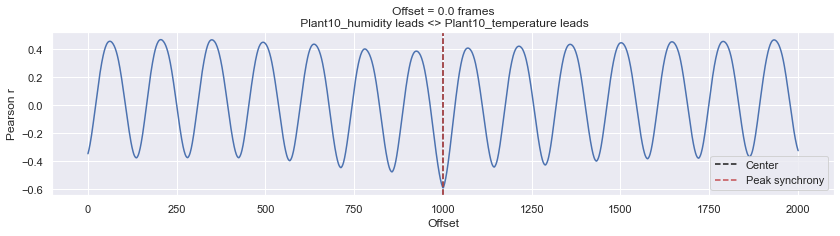

In [16]:
dict_selected = {}

for col in temp.columns:
    select_name = dict_granger[col]
    select_data = [eda[[dict_granger[col][i]]] for i in range(len(dict_granger[col]))]
    
    final_selection = {}
    threshold = 0.5

    for i in range(len(select_data)):
        lags = 1000
        try:
            rs = [crosscorr(select_data[i][select_data[i].columns[0]],y[y.columns[0]], lag) for lag in range(-lags-1,lags+1)]
        except:
            rs = [crosscorr(select_data[i],y[y.columns[0]], lag) for lag in range(-lags-1,lags+1)]
        offset = np.floor(len(rs)/2)-np.argmax(np.abs(rs)) # 최대 correlation 값 가지는 offset 계산 >> 절댓값
        if max(np.abs(rs)) >= threshold:
            final_selection[select_name[i]] = [max(np.abs(rs)), offset]
        f,ax=plt.subplots(figsize=(14,3))
        ax.plot(rs)
        ax.axvline(np.ceil(len(rs)/2),color='k',linestyle='--',label='Center')
        ax.axvline(np.argmax(np.abs(rs)),color='r',linestyle='--',label='Peak synchrony')
        ax.set(title=f'Offset = {offset} frames\n {select_name[i]} leads <> {col} leads', xlabel='Offset',ylabel='Pearson r')
        # ax.set_xticks([0, 50, 100, 151, 201, 251, 301])
        # ax.set_xticklabels([-150, -100, -50, 0, 50, 100, 150]);
        plt.legend()
        
    dict_selected[col] = final_selection
    
dict_selected

In [17]:
for col in temp.columns:
    df_result = pd.DataFrame(dict_selected[col], index=['pearson correlation', 'offset']).T
    df_result.to_csv(col+'_result.csv')

In [20]:
feature2 = [item[0] for item in sorted(dict_selected['Plant2_temperature'].items(), key=lambda x:x[1], reverse=True)]
feature2

['Ahu5_inv',
 'Ahu7_inv',
 'Plant7_dioxide',
 'Ahu4_inv',
 'Ahu11_inv',
 'Ahu9_inv',
 'Ahu1_inv',
 'Ahu13_inv',
 'Ahu3_inv',
 'Plant2_temperature',
 'Ahu8_inv',
 'Ahu12_inv',
 'Ahu10_inv',
 'Plant7_temperature',
 'Ahu2_inv',
 'Ahu14_inv',
 'Plant8_temperature',
 'Ahu6_inv',
 'Plant3_temperature',
 'Plant4_temperature',
 'Plant5_temperature',
 'Plant1_temperature',
 'Plant3_humidity',
 'Plant2_humidity',
 'Plant6_temperature',
 'Plant4_humidity',
 'Plant7_humidity',
 'Plant2_dioxide',
 'Plant3_dioxide',
 'Plant6_dioxide']

In [44]:
feature2_selected = ['Ahu5_inv','Ahu7_inv','Plant7_dioxide','Ahu4_inv','Ahu11_inv','Ahu9_inv', 
                     'Ahu1_inv','Ahu13_inv','Ahu3_inv','Ahu8_inv','Ahu12_inv','Ahu10_inv','Ahu2_inv',
                     'Ahu14_inv','Ahu6_inv','Plant3_humidity','Plant2_humidity','Plant4_humidity',
                     'Plant7_humidity','Plant2_dioxide','Plant3_dioxide','Plant6_dioxide']

feature2_selected.append('Plant2_temperature')

df_arimax = pd.DataFrame(eda[feature2_selected]).interpolate('index').fillna(method='bfill')
df_arimax

,Ahu5_inv,Ahu7_inv,Plant7_dioxide,Ahu4_inv,Ahu11_inv,Ahu9_inv,Ahu1_inv,Ahu13_inv,Ahu3_inv,Ahu8_inv,...,Ahu14_inv,Ahu6_inv,Plant3_humidity,Plant2_humidity,Plant4_humidity,Plant7_humidity,Plant2_dioxide,Plant3_dioxide,Plant6_dioxide,Plant2_temperature
2023-01-31 10:00:00,30.0,30.0,591.0,0.0,30.0,30.0,30.0,30.0,30.0,30.0,...,0.0,0.0,32.15,32.68,32.22,33.05,513.0,538.0,490.0,25.84
2023-01-31 10:10:00,30.0,30.0,591.0,0.0,30.0,30.0,30.0,30.0,30.0,30.0,...,0.0,0.0,32.07,32.34,31.92,32.66,523.0,551.0,493.0,25.88
2023-01-31 10:20:00,30.0,30.0,600.0,0.0,30.0,30.0,30.0,30.0,30.0,30.0,...,0.0,0.0,32.21,32.32,31.92,32.76,529.0,551.0,502.0,25.75
2023-01-31 10:30:00,30.0,30.0,600.0,0.0,30.0,30.0,30.0,30.0,30.0,30.0,...,0.0,0.0,31.86,32.06,31.96,32.80,528.0,553.0,507.0,25.63
2023-01-31 10:40:00,30.0,30.0,600.0,0.0,30.0,30.0,30.0,30.0,30.0,30.0,...,0.0,0.0,31.72,31.58,31.77,32.85,512.0,557.0,507.0,25.63
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-08-01 15:20:00,40.0,35.0,579.0,40.0,45.0,36.0,40.0,45.0,40.0,36.0,...,45.0,35.0,39.38,40.04,39.98,38.66,624.0,623.0,563.0,26.23
2023-08-01 15:30:00,40.0,35.0,571.0,40.0,45.0,36.0,40.0,45.0,40.0,36.0,...,45.0,35.0,40.28,40.41,39.81,38.08,640.0,660.0,564.0,26.08
2023-08-01 15:40:00,40.0,35.0,577.0,40.0,45.0,36.0,40.0,45.0,40.0,36.0,...,45.0,35.0,39.72,40.58,39.81,38.16,635.0,639.0,565.0,26.16
2023-08-01 15:50:00,40.0,35.0,581.0,40.0,45.0,36.0,40.0,45.0,40.0,36.0,...,45.0,35.0,39.52,40.38,39.92,38.16,650.0,628.0,573.0,26.12


In [ ]:
#ARIMAX

df_train = df_arimax[df_arimax.index < '2023-07-01']
df_test = df_arimax[(df_arimax.index >= '2023-07-01')&(df_arimax.index < '2023-08-01')]

arimax = sm.tsa.statespace.SARIMAX(df_train['Plant2_temperature'],exog=df_train.iloc[:,:-1],
                                  order=(1,1,1),seasonal_order=(0,0,0,0)).fit()

In [53]:
pred_arimax = arimax.forecast(steps=4464, exog = df_test.iloc[:,:-1])
print('ARIMAX model MSE:{}'.format(mean_squared_error(df_test[['Plant2_temperature']],pred_arimax)))
print('ARIMAX model MAE:{}'.format(mean_absolute_error(df_test[['Plant2_temperature']],pred_arimax)))
print('ARIMAX model R-Squared:{}'.format(r2_score(df_test['Plant2_temperature'],pred_arimax)))

ARIMAX model MSE:3.56596090983475
ARIMAX model MAE:1.5513645057634542
ARIMAX model R-Squared:-1.8003374448081506


In [54]:
pred

2023-07-01 00:00:00    29.185140
2023-07-01 00:10:00    29.202175
2023-07-01 00:20:00    29.197976
2023-07-01 00:30:00    29.232684
2023-07-01 00:40:00    29.264645
                         ...    
2023-07-31 23:10:00    29.437650
2023-07-31 23:20:00    29.397481
2023-07-31 23:30:00    29.394735
2023-07-31 23:40:00    29.392286
2023-07-31 23:50:00    29.415886
Freq: 10T, Name: predicted_mean, Length: 4464, dtype: float64

In [58]:
#SARIMAX

feature2_selected_sarimax = ['Ahu14_inv','Ahu13_inv','Ahu12_inv','Plant2_dioxide','Plant2_humidity']
feature2_selected_sarimax.append('Plant2_temperature')

df_sarimax = pd.DataFrame(eda[feature2_selected_sarimax]).interpolate('index').fillna(method='bfill')

df_train = df_sarimax[df_sarimax.index < '2023-07-01']
df_test = df_sarimax[(df_sarimax.index >= '2023-07-01')&(df_sarimax.index < '2023-08-01')]

sarimax = sm.tsa.statespace.SARIMAX(df_train['Plant2_temperature'],exog=df_train.iloc[:,:-1],
                                  order=(1,1,1),seasonal_order=(1,1,1,144), simple_differencing=True).fit()

In [59]:
pred_sarimax = sarimax.forecast(steps=4464, exog = df_test.iloc[:,:-1])
print('SARIMAX model MSE:{}'.format(mean_squared_error(df_test[['Plant2_temperature']],pred_sarimax)))
print('SARIMAX model MAE:{}'.format(mean_absolute_error(df_test[['Plant2_temperature']],pred_sarimax)))
print('SARIMAX model R-Squared:{}'.format(r2_score(df_test['Plant2_temperature'],pred_sarimax)))

SARIMAX model MSE:6.1733086578205825
SARIMAX model MAE:2.1515426472484256
SARIMAX model R-Squared:-3.847879107473008
